Image Stitching

In [86]:
# Import packages 
import cv2
import matplotlib.pyplot as plt 
from skimage.feature import corner_harris, corner_peaks
import numpy as np
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib.backends.backend_agg import FigureCanvasAgg
from skimage.metrics import structural_similarity as ssim
import seaborn as sns
import itertools
import Graphs
import gc
import Utils_RANSAC
import Patches
import Visualization
import Distances
import json
from Json_read import Json_read


### Structure: 
modules:
- Distances.py contains functions related to calculating the difference between keypoints according to their descriptor
- Graphs.py contains functions for plotting graphs 
- Patches.py contains functions for generating, plotting and compare  patches created around the inliers and their transformed version, they are compared by SSIM and Norm. MSE
- Visualization.py contrains function for plotting the images with keypoints and the stiched image with inliers
- Utils_RANSAC.py contains other functions 
- json_read: contains the class for creating a json object where it is possible to read and write the best parameters of a run 

## Json files:
- best_param contains best parameters from previous iterations 
- custom_param permit to set new parameters to explore 


The whole sequence of steps can be run by cells in the main section after running the other cells 

### Read images, get images in grayscale, set them as global variable

Shape image 1: (430, 574, 3)
Shape image 2: (430, 574, 3)


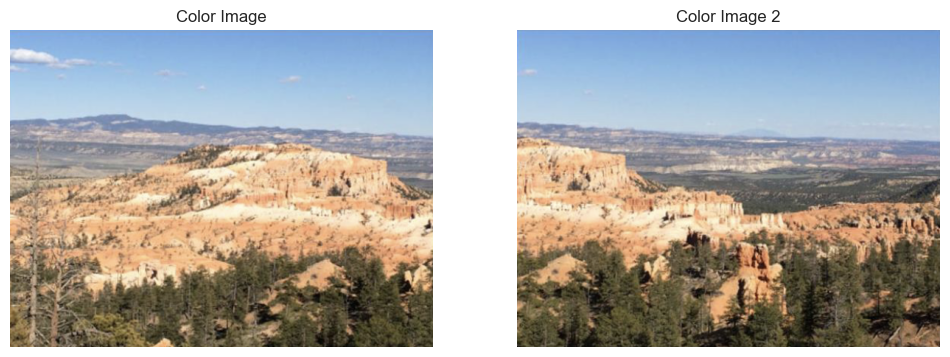

In [87]:
# Display images
def show_images(): 
    global color_image_1,color_image_2
    plt.figure(figsize=(12, 6))

    plt.subplot(1,2, 1)
    plt.imshow(cv2.cvtColor(color_image_1, cv2.COLOR_BGR2RGB))
    print("Shape image 1:", color_image_1.shape)
    plt.title("Color Image")
    plt.axis("off")

    plt.subplot(1,2, 2)
    plt.imshow(cv2.cvtColor(color_image_2, cv2.COLOR_BGR2RGB))
    print("Shape image 2:", color_image_2.shape)
    plt.title("Color Image 2")
    plt.axis("off")

    plt.show()




# Read from files and display images
color_image_1, color_image_2, gray_image_1, gray_image_2 = Utils_RANSAC.read_img_from_files()

show_images()






    

### Best parameters 
Best parameters according to previous iterations are saved on a JSON file, values are saved in a json object

- best SSIM score
- best norm MSE score
- best euclidean distance inliers (deprecated because it is not normalized)

In [88]:


with open('best_param.json', 'r') as file:
        best_param = json.load(file)


# For every list best_x_abs idx 0 best ssim score, 1 best n mse score, 2 eucl res score, 3 overall

json_obj_best = Json_read(best_param[0], best_param[1])





## 1. Harris Corner Detection

Peaks are the local maxima in a region of 2 * min_distance + 1 (i.e. peaks are separated by at least min_distance) in the reponse map 


In [89]:
# Calculate Harris corners

def harris(gray_image, k=0.05, min_distance=1, size=10, plot='on',img_name=''):
   
    # Get Harris corner response 
    harris_corners = corner_harris(gray_image,k=k)

    # Get local maxima from the corner response to get meaningful keypoints
    keypoints = corner_peaks(harris_corners, exclude_border=size//2, min_distance=min_distance) 
    
    # Plot keypoints in the image
    if plot=='on':
      
        for kp in keypoints: 
            plt.plot(kp[1], kp[0], 'rd', markersize= 3, alpha=0.5)
            #plt.plot(kp[1], kp[0], 'bs', markersize=15, alpha=0.2) 
            #plt.text(kp[1] , kp[0], f'{i+1}', fontsize=10, ha='right', va='bottom')
        plt.imshow(cv2.cvtColor(gray_image, cv2.COLOR_GRAY2RGB))
        plt.title(f"{img_name} with keypoints after Harris corner detection")
        plt.tight_layout()
        plt.axis('off')
        plt.show()
  
    return keypoints
    

## 2. SIFT keypoint descriptors


In [90]:
# Calculate SIFT desctriptors
def sift_func(gray_image, img_name='', k=0.05, plot="on",  min_distance=1, size=10):
    
    # Get keypoints from harris corners 
    keypoints = harris(gray_image, min_distance=min_distance, k=k, size=size, plot=plot, img_name=img_name)
    print("Harris corner detection has found ",len(keypoints),  "Keypoints in ", img_name, " for k=",k, " min_distance=",min_distance)
    
    # Compute descriptors for keypoints with size=size
    sift = cv2.SIFT_create()
    keypoints_cv2 = [cv2.KeyPoint(x=float(kp[1]), y=float(kp[0]), size=size) for kp in keypoints]
    kp, des = sift.compute(gray_image, keypoints_cv2)

    # Show descriptor patches in the image 
    if plot=="on":
        sift_image = cv2.drawKeypoints(gray_image, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        plt.imshow(sift_image)
        plt.axis("off")
        plt.title(f"{img_name} after SIFT")
        print(len(keypoints))
        plt.show()
   
    return kp, des    

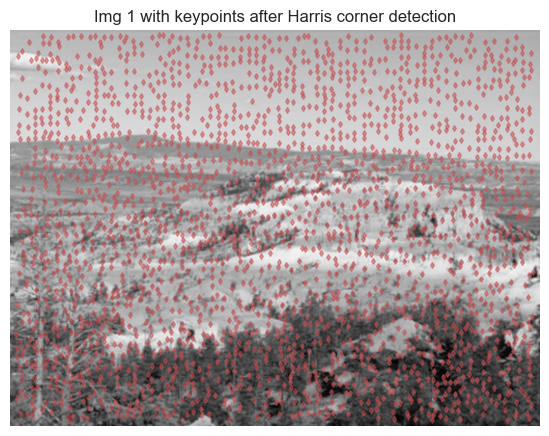

Harris corner detection has found  2313 Keypoints in  Img 1  for k= 0.05  min_distance= 3
2313


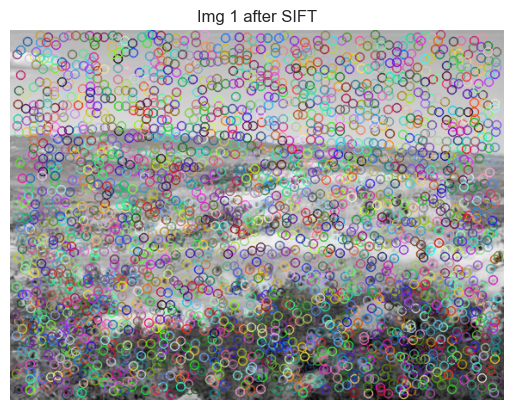

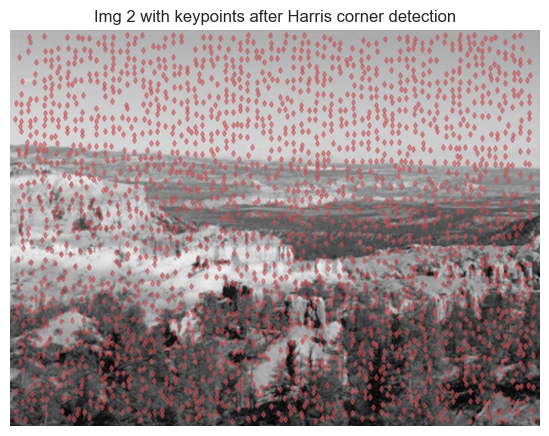

Harris corner detection has found  2397 Keypoints in  Img 2  for k= 0.05  min_distance= 3
2397


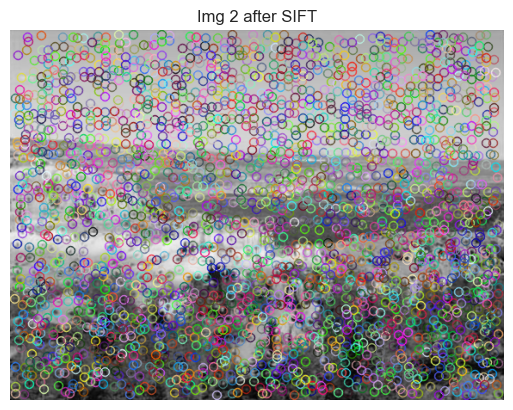

In [91]:
# Display images after Harris corner detection and SIFT
kp_1, des_1 = sift_func(gray_image_1, "Img 1", min_distance=3)
kp_2, des_2 = sift_func(gray_image_2, "Img 2", min_distance =3)

### Compute SIFT for both images

In [92]:
# Compute keypoints and descriptors for both images by SIFT

def sift_all(min_distance=1, size=10, k=0.05, plot='on'): 
    global gray_image_1, gray_image_2
    kp_1, des_1 = sift_func(gray_image_1, img_name="Img 1", k=k, min_distance=min_distance,  size=size, plot=plot)
    kp_2, des_2 = sift_func(gray_image_2, img_name="Img 2", k=k, min_distance=min_distance, size=size, plot=plot)
    

    return kp_1, kp_2, des_1, des_2

### Change the min_distance and k parameter to see how it effects the number of keypoints
Min_distance parameter for corner_peaks change the minimum distance between a peak and another, by default it is 1.

K parameter for harris_corner is usually in between [0, 0.2] lower values contributes to detect sharper edges (by default it is ).

Harris corner detection has found  6926 Keypoints in  Img 1  for k= 0.1  min_distance= 1
Harris corner detection has found  7035 Keypoints in  Img 2  for k= 0.1  min_distance= 1
Harris corner detection has found  6040 Keypoints in  Img 1  for k= 0.05  min_distance= 1


Harris corner detection has found  6167 Keypoints in  Img 2  for k= 0.05  min_distance= 1
Harris corner detection has found  5160 Keypoints in  Img 1  for k= 0.01  min_distance= 1
Harris corner detection has found  5295 Keypoints in  Img 2  for k= 0.01  min_distance= 1
Harris corner detection has found  4071 Keypoints in  Img 1  for k= 0.1  min_distance= 2
Harris corner detection has found  4141 Keypoints in  Img 2  for k= 0.1  min_distance= 2
Harris corner detection has found  3649 Keypoints in  Img 1  for k= 0.05  min_distance= 2
Harris corner detection has found  3763 Keypoints in  Img 2  for k= 0.05  min_distance= 2
Harris corner detection has found  3309 Keypoints in  Img 1  for k= 0.01  min_distance= 2
Harris corner detection has found  3386 Keypoints in  Img 2  for k= 0.01  min_distance= 2
Harris corner detection has found  1302 Keypoints in  Img 1  for k= 0.1  min_distance= 5
Harris corner detection has found  1294 Keypoints in  Img 2  for k= 0.1  min_distance= 5
Harris corner 

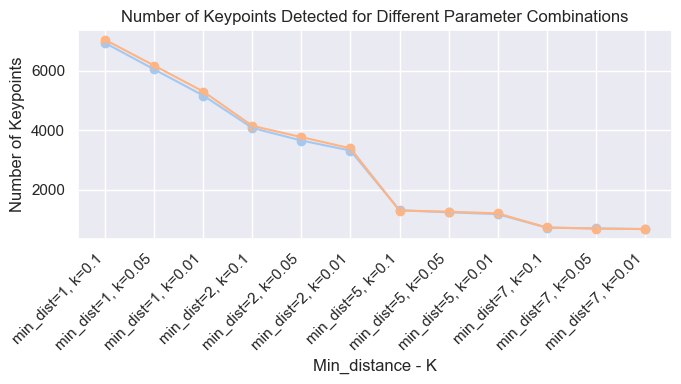

In [100]:
min_dist = [1, 2, 5, 7]
k_list = [0.1, 0.05, 0.01]
nr_kp_1 = []
nr_kp_2 = []

colors = sns.color_palette("pastel")
combination = [str(md)+"-"+str(k) for md in min_dist for k in k_list]
for min in min_dist: 
    for k in k_list: 
    
        k_1, k_2, _, _ = sift_all(min_distance=min,k=k, plot='off')
        nr_kp_1.append(len(k_1))
        nr_kp_2.append(len(k_2))

plt.figure(figsize=(7, 4))
for md in min_dist:
    for k in k_list:
        index = min_dist.index(md) * len(k_list) + k_list.index(k)
        plt.plot(index, nr_kp_1[index], marker='o', color=colors[0])
        plt.plot(index, nr_kp_2[index], marker='o', color=colors[1])


for i in range(len(min_dist) * len(k_list) - 1):
    plt.plot([i, i + 1], [nr_kp_1[i], nr_kp_1[i + 1]], color=colors[0])
    plt.plot([i, i + 1], [nr_kp_2[i], nr_kp_2[i + 1]], color=colors[1])


plt.xticks(range(len(min_dist) * len(k_list)), [f'min_dist={md}, k={k}' for md in min_dist for k in k_list], rotation=45, ha='right')


plt.xlabel('Min_distance - K')
plt.ylabel('Number of Keypoints')
plt.title('Number of Keypoints Detected for Different Parameter Combinations')
plt.tight_layout()
plt.show()    

## 3. Compute distance between descriptors
## 4. Select best matches by top n value

Functions are in Distances.py

## 5. RANSAC

In [94]:
# RANSAC implementation
def ransac(src_points, dst_points, num_iterations=1000, inlier_threshold=2, top_n=100):

    print("in RANSAC")
    
    best_model = None
    best_inliers = []
    best_residual_inliers = float('inf')
    best_residual_tot = float('inf')
    affine_transform = None
    inliers = []
    
    # If num_iterations==0 RANSAC relies on a minimum number of inliers to find instead of a maximum number of iteration (non used)
    # so the nr of iterations is set to a very high value
    #if num_iterations==0: 
       #num_iterations = 1000000
        #min_inliers = 80

    for _ in range(num_iterations):
        # refit model with inliers if there are more than 4
        if len(inliers) > 4:
            affine_transform,s = cv2.findHomography(np.float32([t[0] for t in inliers]), np.float32([t[1] for t in inliers]),0 )
            #affine_transform,s = cv2.fit(np.float32([t[0] for t in inliers]), np.float32([t[1] for t in inliers]),0 )
        
        # otherwise pick random points in both images
        else: 
            sample_indices = random.sample(range(len(src_points)), 5)
            src_sample = np.float32([src_points[i] for i in sample_indices])
            dst_sample = np.float32([dst_points[i] for i in sample_indices])
            affine_transform, s = cv2.findHomography(src_sample, dst_sample,0)
            
        # if the affine trasformation was successfully found then it is possible to look for inliers
        if affine_transform is not None:
            inliers = []
            residuals_tot = []
            residuals_inliers = []
    
            
            
            for src_point, dst_point in zip(src_points, dst_points):
                # Apply the affine transformation to the source point
                src_point_h = np.append(src_point, 1)
                transformed_point = np.dot(affine_transform, src_point_h)
               

                # Calculate the Euclidean distance between the transformed point and the destination point
                residual = np.linalg.norm(transformed_point[:2] - dst_point)
           

                # Classify points based on the residual
                # The point is a inlier if the residual is smaller than then the threshold
                if residual < inlier_threshold:
                    inliers.append((src_point, dst_point))
                    residuals_inliers.append(residual)
            
                residuals_tot.append(residual)

            # Update best model if this model has more inliers
            if len(inliers) > len(best_inliers):
                best_model = affine_transform
                best_inliers = inliers
                best_residual_inliers = residuals_inliers
                best_residual_tot = residuals_tot
                  

            # all the top n points are inliers
            if len(inliers) == top_n:
                    break

                # In case  RANSAC does not rely on a maximum number of iterations check if it has found the minimum number on inliers (not used) 
                #if num_iterations== 1000000: 
                    #if len(best_inliers) > min_inliers: 
                        #break

    # return the affine trasformation, inliers, outliers, residuals for every point, avg residuals, transformed source points
    return best_model, best_inliers,best_residual_inliers, best_residual_tot



## 6. Warp Image 2 onto Image 1 and sticht images together

In [95]:
# Return the stitched image
def stitch_images(color_image_1, color_image_2, affine_model):

    # Calculate height and width for the final image 
    height, width = color_image_1.shape[:2] 
    total_width = width + color_image_2.shape[1]  
    max_height = max(height, color_image_2.shape[0])  

    # Initialize the canvas for the final image with the right size
    canvas = np.zeros((max_height, total_width, 3), dtype=np.uint8)
    canvas[:height, :width,:3] = color_image_1

    #  Warp image2 onto the canvas using the inverse perspective transformation
    cv2.warpPerspective(src=color_image_2,dst=canvas, M=np.linalg.inv(affine_model), dsize=(total_width, max_height))
    
    # Add image1 to the canvas
    canvas[:height, :width,:3] = color_image_1

    # Transformed second image without the first one 
    warped = cv2.warpPerspective(src=color_image_2, M=np.linalg.inv(affine_model), dsize=(width, height))
    return canvas, warped 

 


## 7. Sensitivity Analysis

Metrics for inliers: 

- Average residuals between transformed source point and destination points (based on coordinates) normalized on RANSAC max threshold ranges between 0 and 1 where 0 indicates more closeness 
- Ratio inlier/top_n_keypoints 

Metrics for patch comparison (gray scale pixel value based): 

- SSIM ranges between -1 and 1 where 1 indicates more similarity 
- normalized MSE ranges between 0 and 1 where 0 indicates more similarity 

### Computation of every combination of parameters 

In [96]:


# Compute experiments for all the different values in parameters
def compute(parameters, json_obj_best, display_final_img='on', save_param='off', save_param_force='off', min_ratio_inl=0.5):
    print("save", save_param, save_param_force)
    nr_inliers_list = []
    curr_param_list = []
    curr_param_dict_list = []
    ssim_patch_list = []
    mse_patch_list = []
    eucl_residuals_list = []
    ratio_inliers_kp_list = []

    combinations = list(itertools.product(*parameters.values()))



    # if there is just one combination of parameters plot all the images and not the graphs 
    if len(combinations)==1:
        display_img ='on'
        plot_graphs='off'
    #  if there is more than one plot the graphs but not the images apart from the result if required by display_final_img='on'
    else: 
        display_img ='off'
        plot_graphs='on'  
    # if there are too many parameters combinations dont plot the graphs     
        if len(combinations)>32:
             plot_graphs='off'
            


    #  Iterate for all the possible combinations 
    for combo in combinations:
                        
        copy_image_1 = color_image_1.copy()
        copy_image_2 = color_image_2.copy()


        # Get current parameters 
        distance_type, top_n, ransac_iter, ransac_threshold, peak_min_distance, patch_size, k  = combo

        # Dictionary containing current parameters 
        curr_parameters =  {key: None for key in parameters}
        for idx, key in enumerate(curr_parameters.keys()):
            curr_parameters[key] = combo[idx]
            print(f'{key}: {curr_parameters[key]}\n')

        
        # Compute SIFT and Harris corners
        kp_1, kp_2, des_1, des_2 = sift_all(min_distance=peak_min_distance, k=k, size=patch_size,plot=display_img)
        
        # Calculate distances between keypoints descriptors
        distance = Distances.compute_distance(distance_type, des_1, des_2)
        
        # Get best matches according to top n
        matches_concat = Distances.select_best_matches(distance, top_n)
        
        # Get source points and destination points,correspondent points are in the same index
        source_points, destination_points = Utils_RANSAC.get_src_dst_points(matches_concat, kp_1, kp_2)
        
        # Compute RANSAC
        affine_model, inliers, residuals_inliers, residuals_tot = ransac(source_points, destination_points, num_iterations=ransac_iter, inlier_threshold= ransac_threshold, top_n=top_n)
     
         # Average of residuals for inliers and for every keypoint                     
        residual_tot_avg = np.mean(residuals_tot)   
        residual_inliers_avg = np.mean(residuals_inliers)  
        # normalized by the max value of the ransac distance threshold considered
        residual_inliers_avg_norm = np.mean([(x - np.min(residuals_inliers)) / max(parameters["RANSAC inlier threshold"]) for x in residuals_inliers])
        ratio_inliers_kp =   len(inliers)/len(source_points)
        


        # Print RANSAC metrics
        print("Number of inliers:", len(inliers))
        print("Number of outliers:", len(source_points) - len(inliers))
        print("Average residual for inliers:", residual_inliers_avg)
        print("Average residual for inliers (norm by ransac ts):", residual_inliers_avg_norm)
        print("Average residual for all the keypoints:", residual_tot_avg)
        print("Ratio inliers/ top_n keypoints:", ratio_inliers_kp)
        
        
        
        
        
        # Save RANSAC metrics 
        ransac_stats = { "Total points per image": len(source_points), "Nr. Inliers": len(inliers), "Nr. Outliers":len(source_points) -len(inliers), "Avg inlier residual": np.mean(residuals_inliers) }
        

        if display_img == 'on':
        
            # Scatter keypoints divided by inliers and outliers on both images 
            Visualization.scatter_points(copy_image_1, copy_image_2, source_points, destination_points, inliers)
            # Visualize RANSAC output 
            Visualization.ransac_visualization(copy_image_1, copy_image_2, source_points, destination_points, inliers,curr_parameters, ransac_stats, plot="on")
        
        
        
        # Stitch images (and get the second image with the transformation)
        canvas, warped = stitch_images(color_image_1, color_image_2, affine_model)

        # Get second image inliers transformed according to the inverse transformation matrix
        transformed_dest_inl = []
        for idx, pt in  enumerate([t[1] for t in inliers]): 
            pt_h = np.append(pt,1)
            pt_transf = np.dot( np.linalg.inv(affine_model), pt_h,)
            transformed_dest_inl.append(pt_transf[:2])
            
        if display_final_img == 'on' or display_img =='on':
            # Scatter inliers on stitched image
            Visualization.scatter_points_on_stiched_img(canvas,[t[0] for t in inliers], transformed_dest_inl, inliers )
            #Visualize stiched image 
            Visualization.stitched_image_visualization(canvas, curr_parameters)

        
        # Find patches in destination points and in the transformed destination points and check for similarity
        patches_original, patches_transformed = Patches.generate_patches(color_image_2, warped, [t[1] for t in inliers],transformed_dest_inl, plot=display_img)
        ssim_avg, mse_avg = Patches.compare_patches(patches_original, patches_transformed)
        
        ssim_patch_list.append(ssim_avg)
        mse_patch_list.append(mse_avg)
        eucl_residuals_list.append(residual_inliers_avg_norm)

       # ifplot_graphs=='on':
            #scatterplot_distance_keypoints(source_points, destination_points, residuals_inlier_avg,  residuals_tot, inliers)

    
        
        param_string = '\n'.join([f'{v}' for k, v in list(curr_parameters.items())])
        curr_param_list.append(param_string)
        ratio_inliers_kp_list.append(ratio_inliers_kp)
        curr_param_dict_list.append(curr_parameters)
        nr_inliers_list.append(len(inliers))

        print("------------------------------------------")

        print("save param", save_param, save_param_force)
    if len(combinations)> 1 and plot_graphs=='on':
        # Plot histogram for nr inliers in the best trasformation, SSIM, MSE, euclidean inlier residuals average
        Graphs.hist_nr_inliers(nr_inliers_list, curr_param_list, parameters.keys())
        Graphs.plot_patch_metrics(ssim_patch_list, mse_patch_list, curr_param_list, nr_inliers_list, parameters.keys())
        Graphs.hist_nr_residuals(eucl_residuals_list, curr_param_list, parameters.keys())




    # Here all combinations of parameters are been used for stiching the images so it is possible to evualuate which is the best one

    # Get all the best average scores among different parameters
    best_ssim = max(ssim_patch_list)
    best_ssim_idx = ssim_patch_list.index(best_ssim)
    best_norm_mse = np.min(mse_patch_list)
    best_norm_mse_idx = mse_patch_list.index(best_norm_mse)
    best_eucl_res = np.min(eucl_residuals_list)
    best_eucl_idx = eucl_residuals_list.index(best_eucl_res)
 


    # Print the best combination of parameters according to every metric

    print("Higher average SSIM score in inlier patches", best_ssim , " obtained with parameters: \n")
    
    for k, v in curr_param_dict_list[best_ssim_idx].items():
        print(f"{k}: {v}")
    print("with ratio inliers/keypoints:", ratio_inliers_kp_list[best_ssim_idx])
    print("\n")    
    print("Lower MSE score in inlier patches", best_norm_mse, " obtained with parameters: \n")
    for k,v in curr_param_dict_list[best_norm_mse_idx].items():
        print(f"{k}: {v}")
    print("with ratio inliers/keypoints:", ratio_inliers_kp_list[best_norm_mse_idx])    
    print("\n")       
    print("Lower Euclidean residual inliers average (norm)", best_eucl_res, " obtained with parameters: \n")    
    for k,v in curr_param_dict_list[best_eucl_idx].items():
        print(f"{k}: {v}")
    print("with ratio inliers/keypoints:", ratio_inliers_kp_list[best_eucl_idx])     
    print("\n")
   

    if (save_param=='on'):

        # Eventually update best param  in json_obj
        best_param_curr = [curr_param_dict_list[best_ssim_idx],curr_param_dict_list[best_norm_mse_idx],curr_param_dict_list[best_eucl_idx]] 
        best_scores_curr = [best_ssim, best_norm_mse, best_eucl_res]
        ratio_inliers_curr = [ratio_inliers_kp_list[best_ssim_idx],ratio_inliers_kp_list[best_norm_mse_idx],ratio_inliers_kp_list[best_eucl_idx]]
        best_scores_new = [0.0, 0.0, 0.0]
        


        
        # get best vaues by json_read object 
        best_param_abs, best_scores_abs = json_obj_best.parameters, json_obj_best.results
        flag_update= 0
        best_param_new = best_param_abs.copy()

        # check if some new best parameters are better then the previous according to their scores
    

        best_scores_new[0] = np.max([best_scores_curr[0], best_scores_abs[0]])
        best_scores_new[1] = np.min([best_scores_curr[1], best_scores_abs[1]])
        best_scores_new[2] = np.min([best_scores_curr[2], best_scores_abs[2]])



        if (save_param_force=='on'):
            
            best_scores_new[0] = best_scores_curr[0]
            best_scores_new[1] = best_scores_curr[1]
            best_scores_new[2] = best_scores_curr[2]


        for h in range(3): 
        
            #update with best parameters 
            #if save_param_force is off compare the ones from previous runs and the new ones 
            # if save_param_force is on subscribe the ones from the current run even if it is worse
            
            if (best_scores_new[h] == best_scores_curr[h]):
                
                best_param_new[h] = best_param_curr[h].copy()
                

            # check if there are few found inliers, in that case other metrics might be non relevant so go back 
                if ratio_inliers_curr[h] < min_ratio_inl:  
                    
                    best_param_new[h] = best_param_abs[h].copy()
                    best_scores_new[h] = best_scores_abs[h]
                    
                # at least one was updated    
                else:
                     flag_update = 1    

       
        # if best parameters were update then rewrite the json file
        if flag_update == 1:
            print(best_param_new)
            # update object, update json
            json_obj_best.set_json(best_param_new, best_scores_new)

            

###  Set parameters

Parameters can be added and changed from the json file custom_param.json



- distance_type: how the distance is calculated between SIFT descriptors

- top_n_values = number of keypoints in each image selected by distance type between their SIFT descriptors

- ransac_iterations = iterations of RANSAC 

- ransac_inlier_threshold = euclidean distance threshold for the cordinates of source points and transformed source points if the distance il lower than the threshold the point is an inlier

- peak_min_distance = used after Harris corner detection for selecting local maxima among the corners in corner_peaks, set a minimum distance that has to be mainted form selecting the the local maxima among corners 

- patch_size = size of the patch around the keypoint descripted by SIFT descriptor 

- k= in Harris corner detection determines how much it is sensitive in variations in intensity and structure, smaller values detects only strong variatrion such as sharp edges

In [97]:
# Read images, assign parameters and call compute()

def  init(json_obj_best, img_1_path='', img_2_path='', param_flag='custom', display_final_img='on', save_param='off', save_param_force='off', min_ratio_inl=0.5): 
    global color_image_1, color_image_2, gray_image_1, gray_image_2 
    print("save", save_param, save_param_force)
    # Get assignment images by deafault 
    if img_1_path=='': 
        color_image_1, color_image_2, gray_image_1, gray_image_2  = Utils_RANSAC.read_img_from_files()

    

    # Only one image path was passed, split it and stitch it again 
    elif img_2_path=='': 
                          
        color_image_1, color_image_2  =  Utils_RANSAC.split_image(img_1_path)
        gray_image_1, gray_image_2 = Utils_RANSAC.convert_to_gray()
        
        

    # read paths of the 2 images 
    else: 
        color_image_1, color_image_2, gray_image_1, gray_image_2 = Utils_RANSAC.read_img_from_files(img_1_path, img_2_path)

    # if save_param_force is on then save_param ia on as well
    if save_param_force == 'on':   
        save_param ='on' 

    best_param_abs, best_scores_abs = json_obj_best.parameters, json_obj_best.results
   

    if param_flag == 'custom':
        
        with open ('custom_param.json', 'r') as file: 
            parameters = json.load(file)
        
        compute(parameters, json_obj_best, display_final_img=display_final_img, save_param=save_param, save_param_force=save_param_force, min_ratio_inl=min_ratio_inl)
       

    # Or use a combination of parameters that was already used another time that obtained the best normalized ssim score

    
    elif param_flag == 'best_ssim':
        print(best_param_abs[0])
   
        par = Utils_RANSAC.create_parameters_dict_from_list(*(best_param_abs[0].values()))    
        compute(par, json_obj_best,  display_final_img=display_final_img, save_param=save_param, save_param_force=save_param_force, min_ratio_inl=min_ratio_inl)


    elif param_flag ==  'best_mse':
        par = Utils_RANSAC.create_parameters_dict_from_list(*(best_param_abs[1].values()))
        compute(par, json_obj_best,  display_final_img=display_final_img, save_param=save_param, save_param_force=save_param_force, min_ratio_inl=min_ratio_inl)


    elif param_flag ==  'best_eucl_res': 
        par = Utils_RANSAC.create_parameters_dict_from_list(*(best_param_abs[2].values()))
        compute(par, json_obj_best,  display_final_img=display_final_img, save_param=save_param, save_param_force=save_param_force, min_ratio_inl=min_ratio_inl)


    else : 
        if best_param_abs[0] is None or  best_param_abs[1] is None or  best_param_abs[2] or  None:

            print("run with param_flag=custom, there are not saved best parameters")
        else: 
            print("ERROR: please set param to a known value, choose between: 'custom', 'best_ssim','best_mse' or 'best_eucl_res' ")
        
    
    



## Main: run all the steps 
### RUN on assignment images
Init function has 5 parameters: 
- img_1_path (if no image path is assigned it will use assignment images)

- img_2_path (if no image path is assigned it will split in 2 the image in img_1_path)

- param_flag: for deciding how to set the parameters  ('custom' , 'best_ssim','best_mse', 'best_eucl_res ) default: custom 
custom get parameters from custom_param.json the other values fthe corresponding ones from bet_param.json

- display_final_img: for displaying ONLY the stiched image at the end and not the ones from intermediate steps('on','off') default: on
(the images from all the steps are printed only if there is a single combinations of paraemeters)

- save_param: for saving the best parameters if they are better then ones in previous runs  ('on','off') default: off, on is save_param_force is on

- save_param_force = for saving the best parameters even if they are not better than the ones from previous runs ('on','off') default: off 

- min_ratio_inl = nr_inliers/top_n   for saving new parameters in json (0,1) default: 0.5
 (IF THIS IS CONDITION IS NOT SATISFIED save_param_force will not update the value )


save on on
save on on
Distance type: eucl

Top n values: 100

RANSAC iterations: 1000

RANSAC inlier threshold: 2

Peak min distance: 3

SIFT Patch size: 15

k Harris: 0.01

Harris corner detection has found  2172 Keypoints in  Img 1  for k= 0.01  min_distance= 3
Harris corner detection has found  2226 Keypoints in  Img 2  for k= 0.01  min_distance= 3


For top_n 100, number of matches: 100 
in RANSAC
Number of inliers: 93
Number of outliers: 7
Average residual for inliers: 0.9663450299556866
Average residual for inliers (norm by ransac ts): 0.21396679629052895
Average residual for all the keypoints: 1.0567841966577711
Ratio inliers/ top_n keypoints: 0.93
SSIM similarity between inlier patches: 0.880572198940936
MSE distance between inlier patches: 0.09103938172043012
------------------------------------------
save param on on
Distance type: eucl

Top n values: 100

RANSAC iterations: 1000

RANSAC inlier threshold: 2

Peak min distance: 3

SIFT Patch size: 15

k Harris: 0.05

Harris corner detection has found  2289 Keypoints in  Img 1  for k= 0.05  min_distance= 3
Harris corner detection has found  2363 Keypoints in  Img 2  for k= 0.05  min_distance= 3
For top_n 100, number of matches: 100 
in RANSAC
Number of inliers: 93
Number of outliers: 7
Average residual for inliers: 0.8422998031629328
Average residual for inliers (norm by ransa

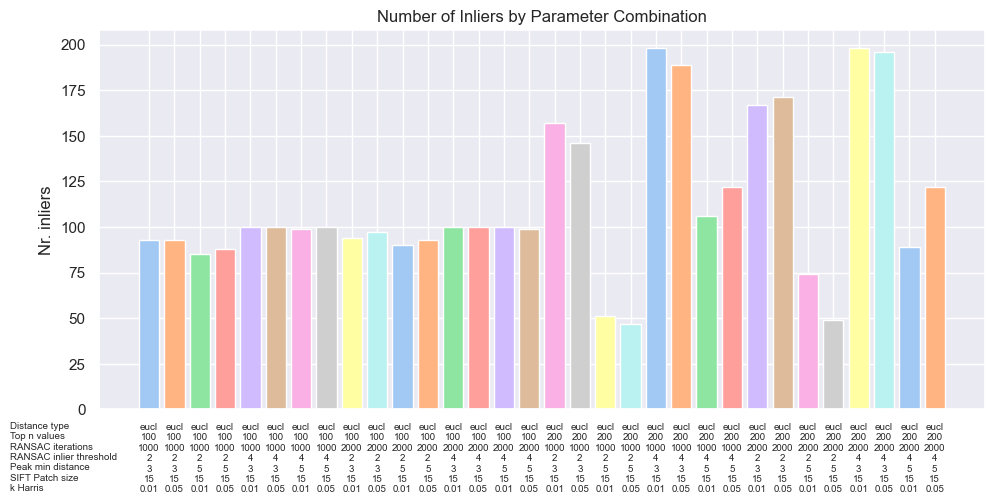

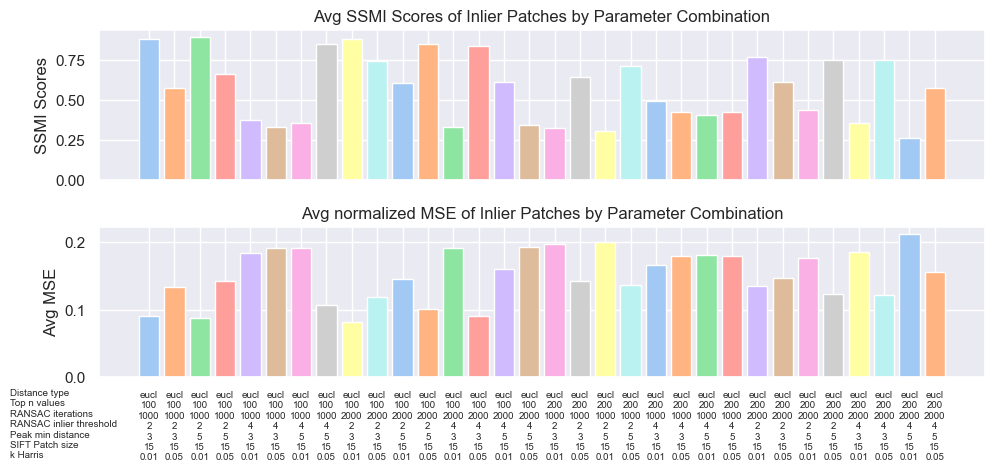

Higher average SSIM score in inlier patches 0.88984658057137  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.85


Lower MSE score in inlier patches 0.0824441489361702  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 2000
RANSAC inlier threshold: 2
Peak min distance: 3
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.94


Lower Euclidean residual inliers average (norm) 0.18921085484347896  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 2000
RANSAC inlier threshold: 2
Peak min distance: 3
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.94


[{'Distance type': 'eucl', 'Top n values': 100, 'RANSAC iterations': 1000, 'RANSAC inlier threshold': 2, 'Peak min distance': 5, 'SIFT Patch size': 15, 'k Harris': 0.01}, {'Distance typ

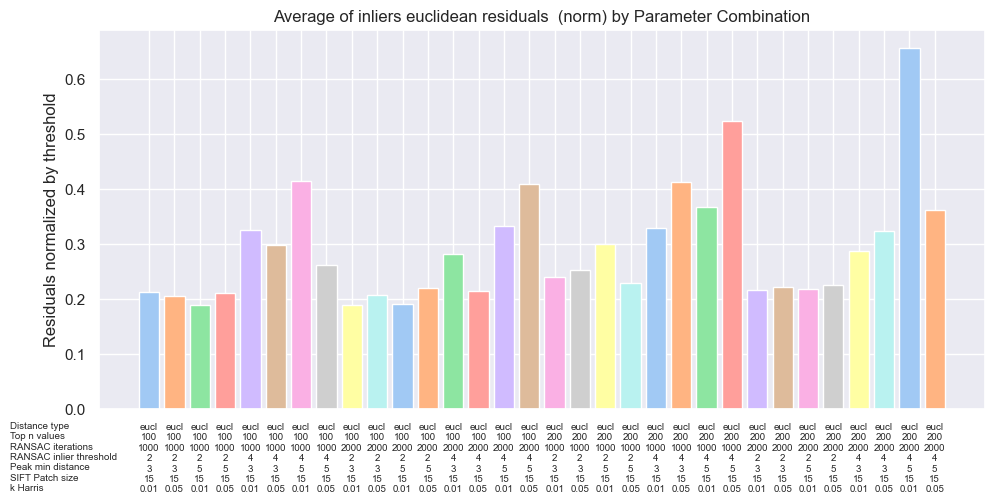

In [99]:
# Run on assignment images with several combinations of parameters from json customm_param.json

color_image_1, color_image_2, gray_image_1, gray_image_2 = Utils_RANSAC.read_img_from_files()
init(json_obj_best, param_flag='custom', display_final_img='off', save_param='on', save_param_force='on')


### Display steps in assignment images according to the best performing combination of parameters 

Display steps with parameters that get the best SSMI 
save off off
{'Distance type': 'eucl', 'Top n values': 100, 'RANSAC iterations': 1000, 'RANSAC inlier threshold': 2, 'Peak min distance': 5, 'SIFT Patch size': 15, 'k Harris': 0.01}
save off off
Distance type: eucl

Top n values: 100

RANSAC iterations: 1000

RANSAC inlier threshold: 2

Peak min distance: 5

SIFT Patch size: 15

k Harris: 0.01



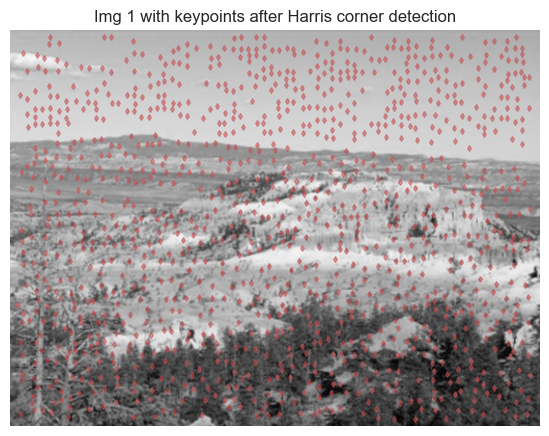

Harris corner detection has found  1158 Keypoints in  Img 1  for k= 0.01  min_distance= 5
1158


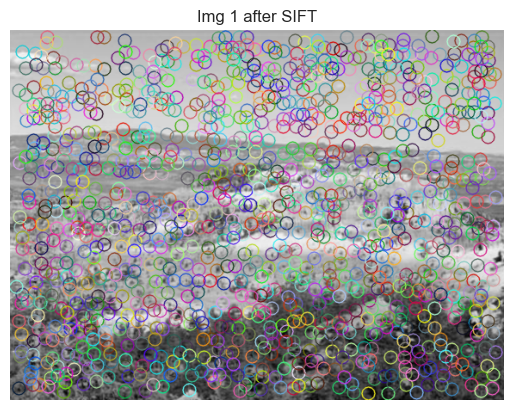

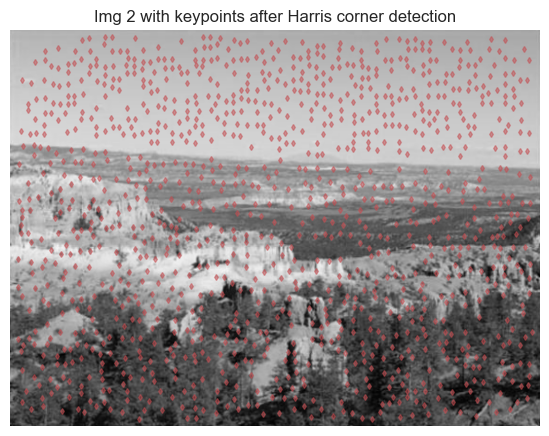

Harris corner detection has found  1194 Keypoints in  Img 2  for k= 0.01  min_distance= 5
1194


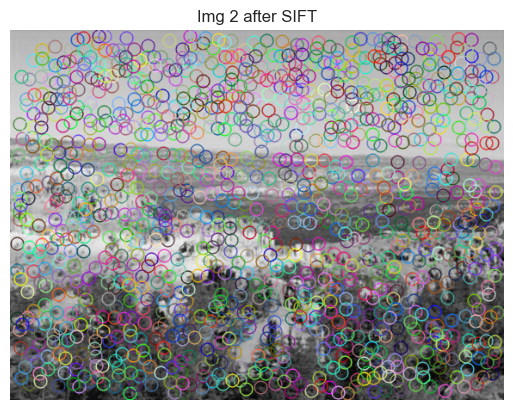

For top_n 100, number of matches: 100 
in RANSAC
Number of inliers: 88
Number of outliers: 12
Average residual for inliers: 1.0448645807592654
Average residual for inliers (norm by ransac ts): 0.42767637004245995
Average residual for all the keypoints: 1.252177322123542
Ratio inliers/ top_n keypoints: 0.88


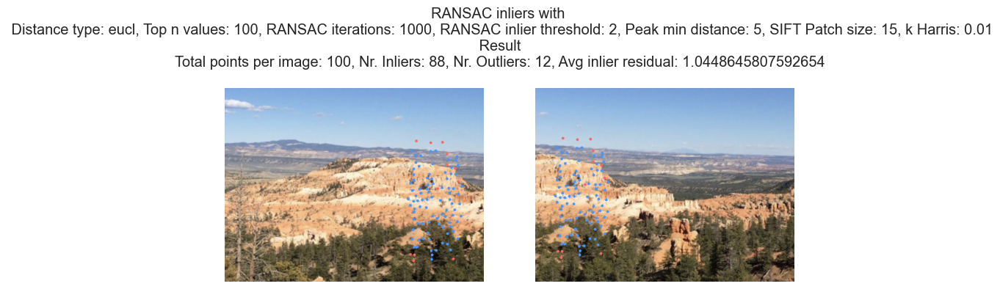

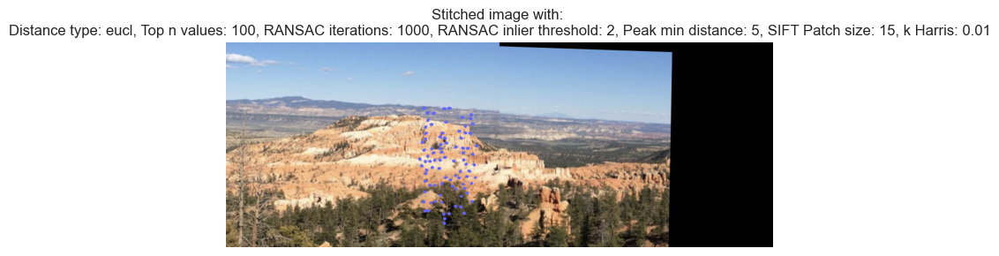

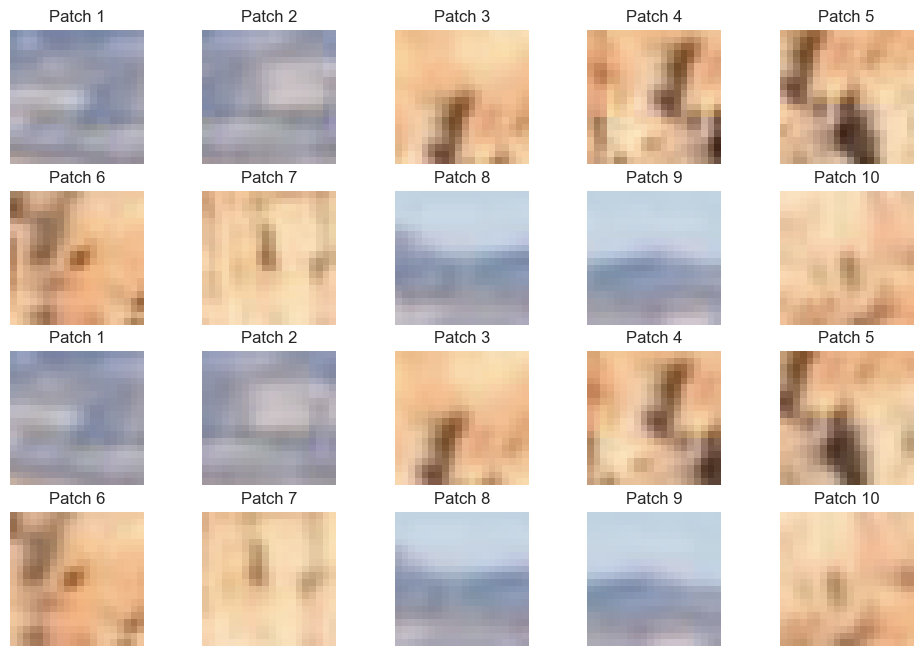

SSIM similarity between inlier patches: 0.7932256652068663
MSE distance between inlier patches: 0.11430390624999999
------------------------------------------
save param off off
Higher average SSIM score in inlier patches 0.7932256652068663  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.88


Lower MSE score in inlier patches 0.11430390624999999  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.88


Lower Euclidean residual inliers average (norm) 0.42767637004245995  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.88


----

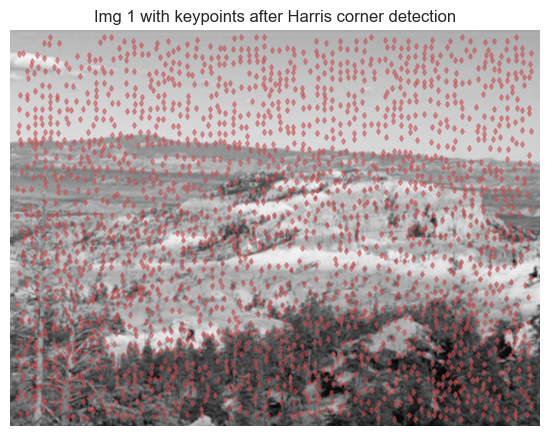

Harris corner detection has found  2172 Keypoints in  Img 1  for k= 0.01  min_distance= 3
2172


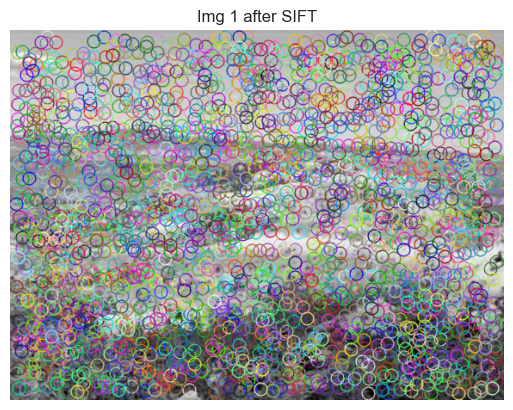

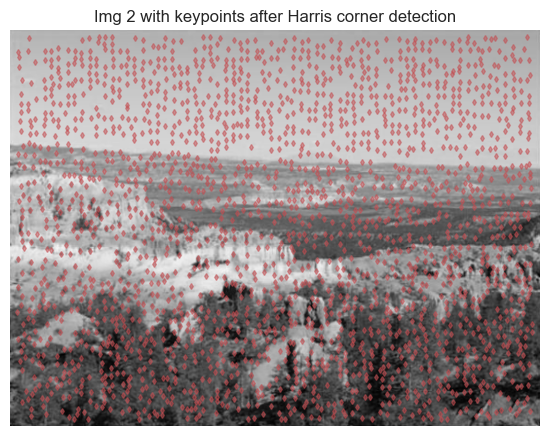

Harris corner detection has found  2226 Keypoints in  Img 2  for k= 0.01  min_distance= 3
2226


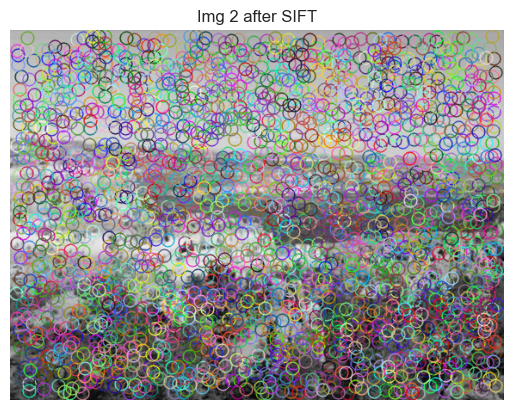

For top_n 100, number of matches: 100 
in RANSAC
Number of inliers: 97
Number of outliers: 3
Average residual for inliers: 0.9960669868770679
Average residual for inliers (norm by ransac ts): 0.48119997284657895
Average residual for all the keypoints: 1.0410100172748171
Ratio inliers/ top_n keypoints: 0.97


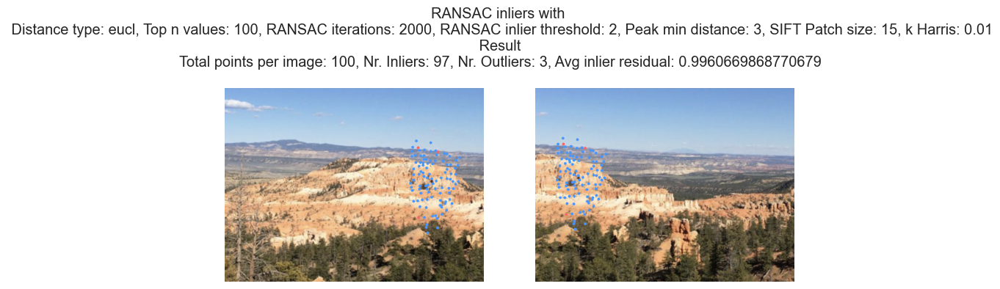

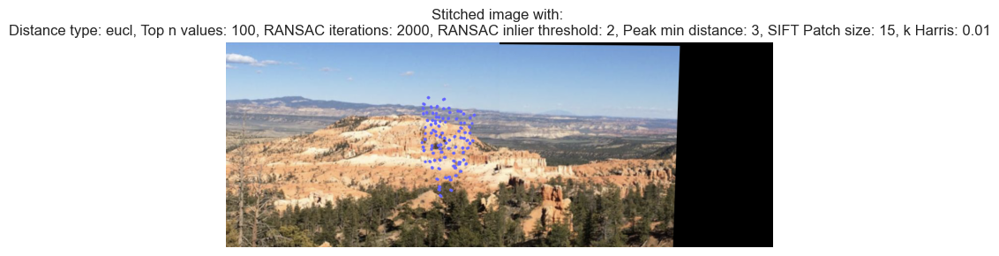

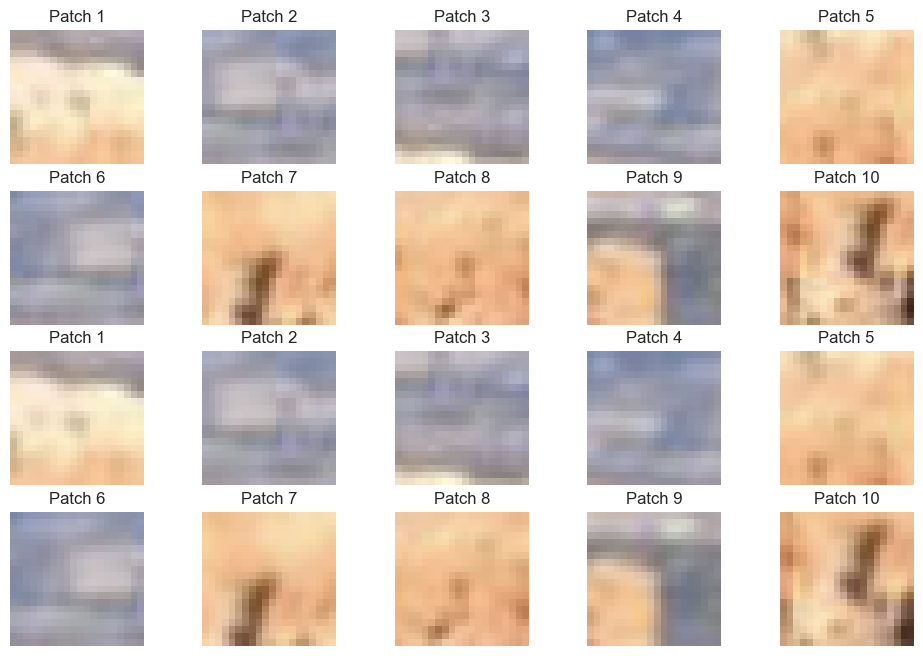

SSIM similarity between inlier patches: 0.7986578472060366
MSE distance between inlier patches: 0.10630567010309279
------------------------------------------
save param off off
Higher average SSIM score in inlier patches 0.7986578472060366  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 2000
RANSAC inlier threshold: 2
Peak min distance: 3
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.97


Lower MSE score in inlier patches 0.10630567010309279  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 2000
RANSAC inlier threshold: 2
Peak min distance: 3
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.97


Lower Euclidean residual inliers average (norm) 0.48119997284657895  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 2000
RANSAC inlier threshold: 2
Peak min distance: 3
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.97


----

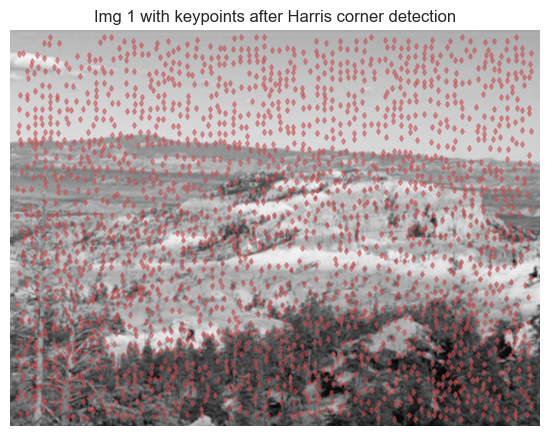

Harris corner detection has found  2172 Keypoints in  Img 1  for k= 0.01  min_distance= 3
2172


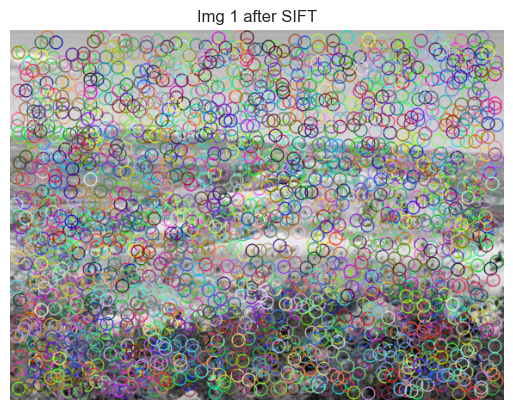

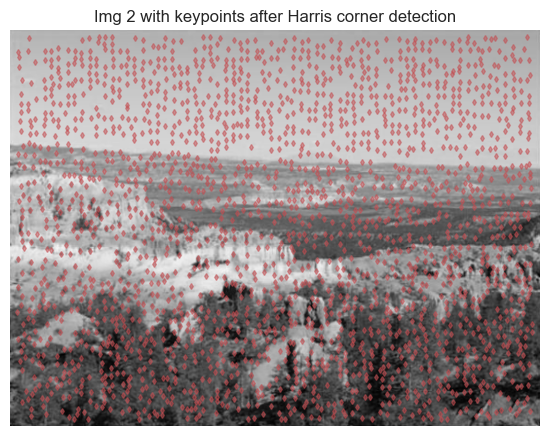

Harris corner detection has found  2226 Keypoints in  Img 2  for k= 0.01  min_distance= 3
2226


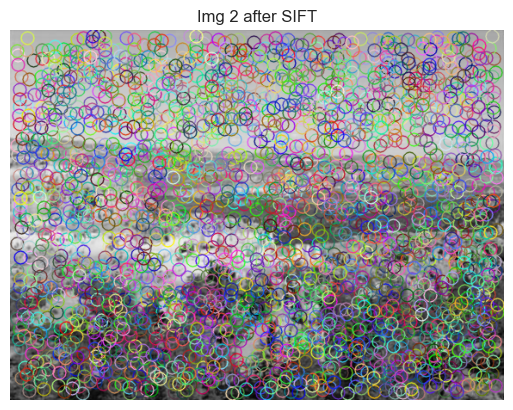

For top_n 100, number of matches: 100 
in RANSAC
Number of inliers: 94
Number of outliers: 6
Average residual for inliers: 0.9506706575657505
Average residual for inliers (norm by ransac ts): 0.45975165088375747
Average residual for all the keypoints: 1.0313425395205764
Ratio inliers/ top_n keypoints: 0.94


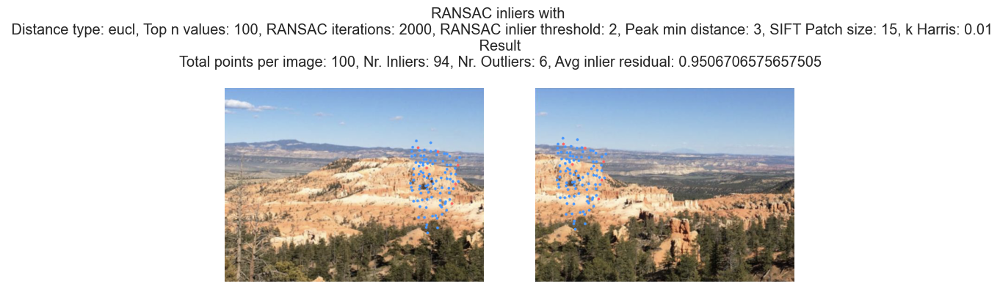

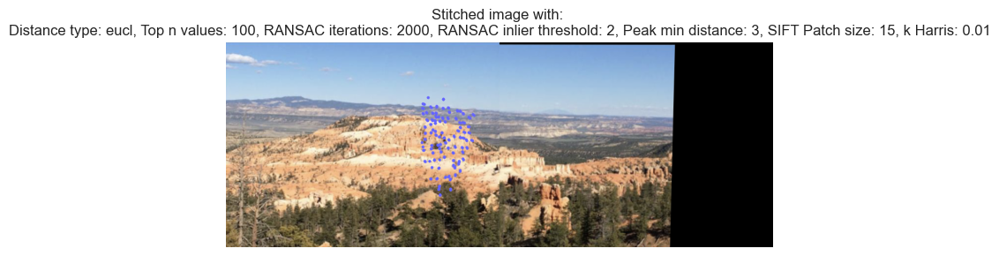

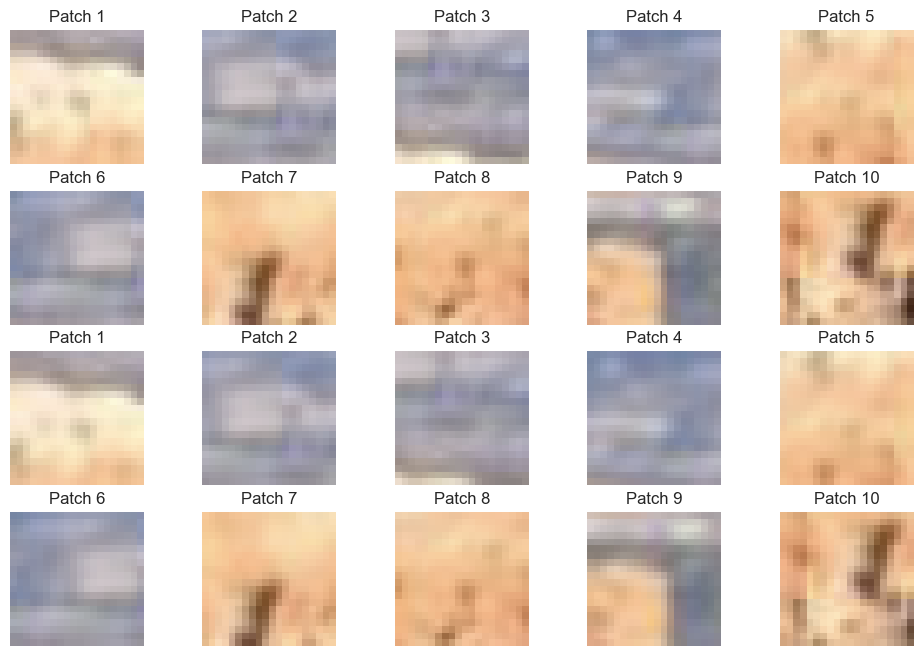

SSIM similarity between inlier patches: 0.8643729907364559
MSE distance between inlier patches: 0.09449840425531918
------------------------------------------
save param off off
Higher average SSIM score in inlier patches 0.8643729907364559  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 2000
RANSAC inlier threshold: 2
Peak min distance: 3
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.94


Lower MSE score in inlier patches 0.09449840425531918  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 2000
RANSAC inlier threshold: 2
Peak min distance: 3
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.94


Lower Euclidean residual inliers average (norm) 0.45975165088375747  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 2000
RANSAC inlier threshold: 2
Peak min distance: 3
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.94




In [102]:

json_obj_best.update_from_json()


print("Display steps with parameters that get the best SSMI ")
color_image_1, color_image_2, gray_image_1, gray_image_2 = Utils_RANSAC.read_img_from_files()
init(json_obj_best, param_flag='best_ssim', display_final_img='on')
print('------------------------------------------------------\n')
print("Display steps with parameters that get the best norm MSE ")
color_image_1, color_image_2, gray_image_1, gray_image_2 = Utils_RANSAC.read_img_from_files()
init(json_obj_best, param_flag='best_mse', display_final_img='on')
print('------------------------------------------------------\n')
print("Display steps with parameters that get the best eucl residual distance (norm) ")
init(json_obj_best, param_flag='best_eucl_res' , display_final_img='on')
color_image_1, color_image_2, gray_image_1, gray_image_2 = Utils_RANSAC.read_img_from_files()

## 8. Test on other images

save off off
{'Distance type': 'eucl', 'Top n values': 100, 'RANSAC iterations': 1000, 'RANSAC inlier threshold': 2, 'Peak min distance': 5, 'SIFT Patch size': 15, 'k Harris': 0.01}
save off off
Distance type: eucl

Top n values: 100

RANSAC iterations: 1000

RANSAC inlier threshold: 2

Peak min distance: 5

SIFT Patch size: 15

k Harris: 0.01



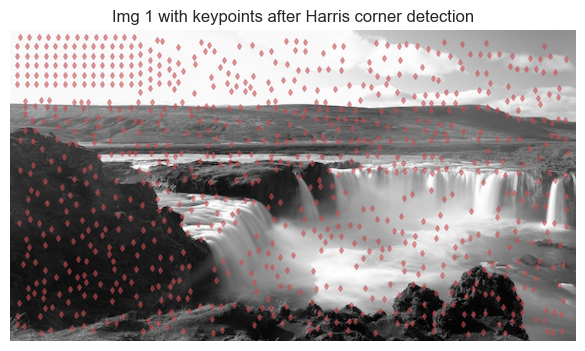

Harris corner detection has found  867 Keypoints in  Img 1  for k= 0.01  min_distance= 5
867


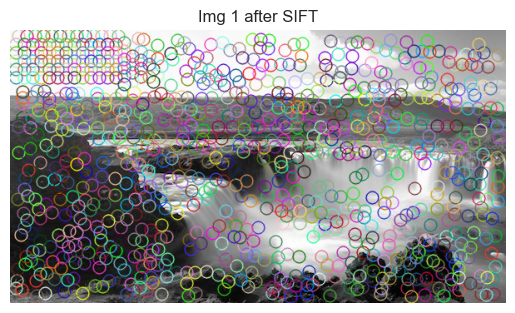

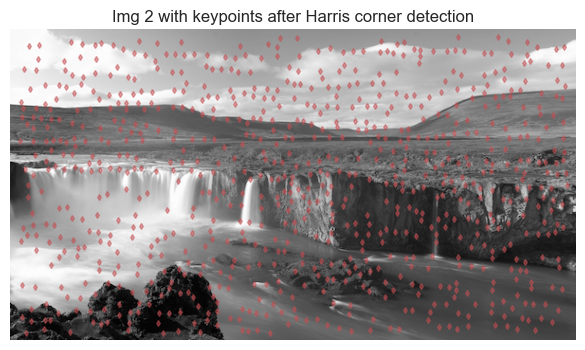

Harris corner detection has found  808 Keypoints in  Img 2  for k= 0.01  min_distance= 5
808


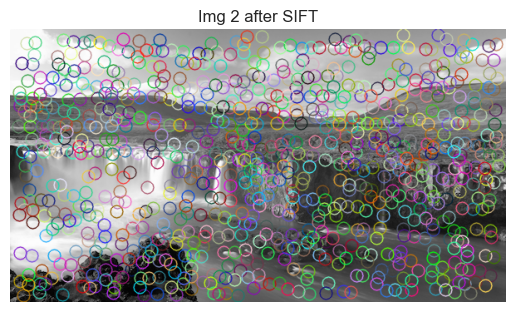

For top_n 100, number of matches: 100 
in RANSAC
Number of inliers: 100
Number of outliers: 0
Average residual for inliers: 3.5854741205160413e-12
Average residual for inliers (norm by ransac ts): 1.4791107084471474e-12
Average residual for all the keypoints: 3.5854741205160413e-12
Ratio inliers/ top_n keypoints: 1.0


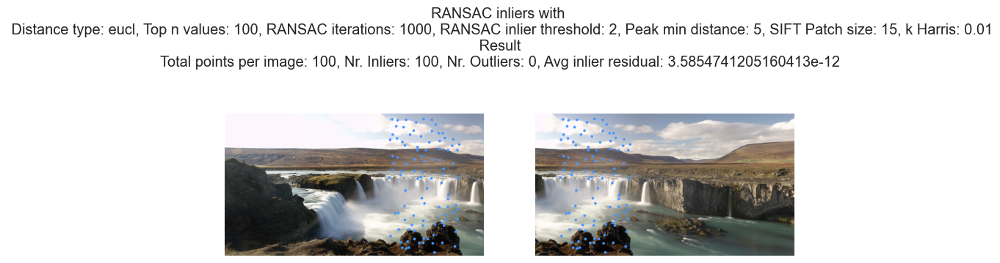

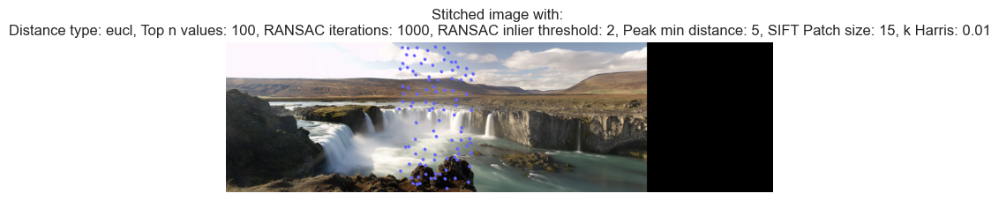

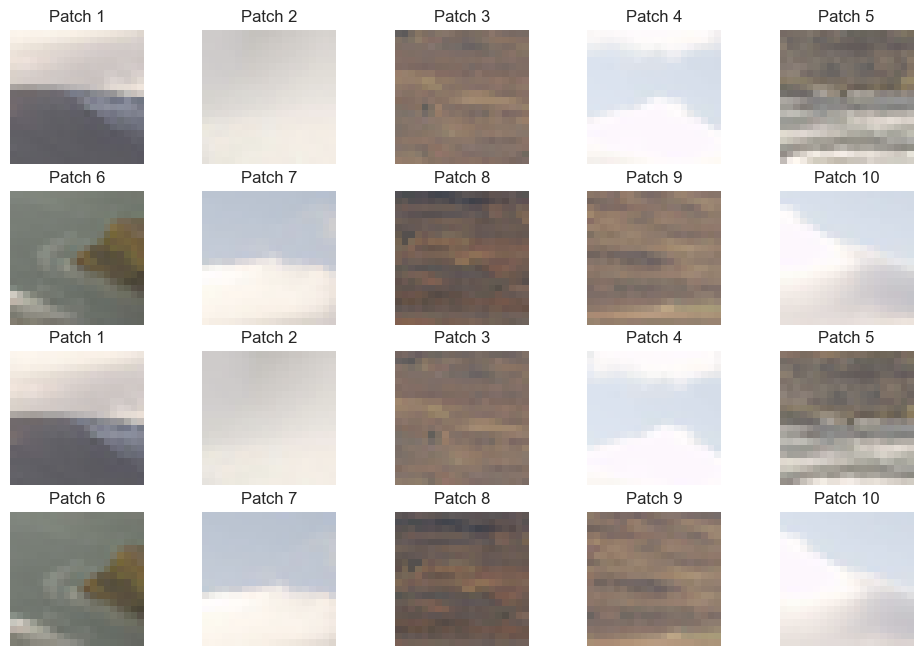

SSIM similarity between inlier patches: 0.7052482377123886
MSE distance between inlier patches: 0.10917683080808079
------------------------------------------
save param off off
Higher average SSIM score in inlier patches 0.7052482377123886  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 1.0


Lower MSE score in inlier patches 0.10917683080808079  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 1.0


Lower Euclidean residual inliers average (norm) 1.4791107084471474e-12  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 1.0


save

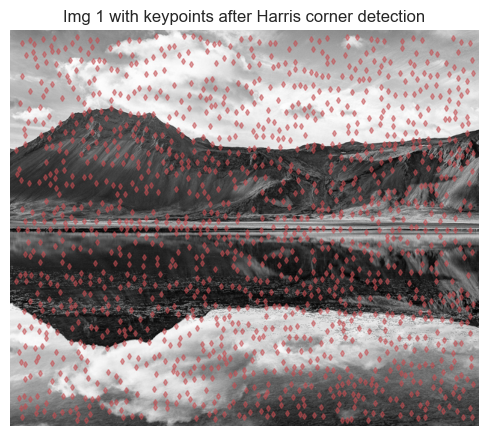

Harris corner detection has found  1451 Keypoints in  Img 1  for k= 0.01  min_distance= 5
1451


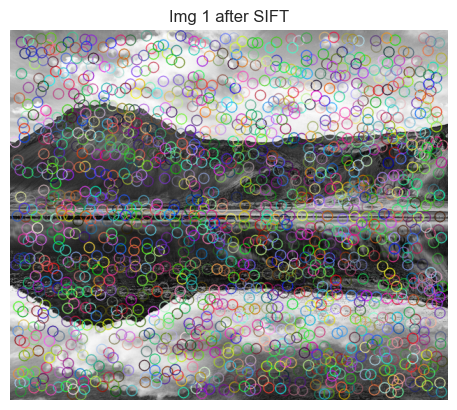

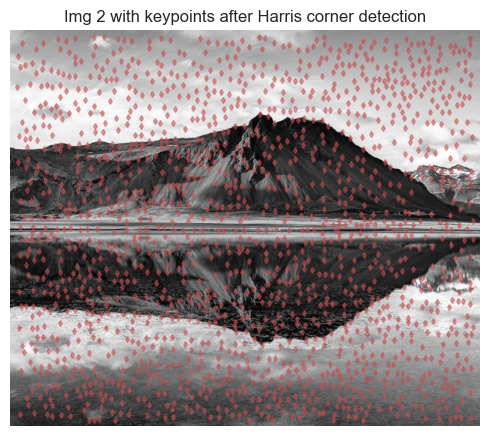

Harris corner detection has found  1550 Keypoints in  Img 2  for k= 0.01  min_distance= 5
1550


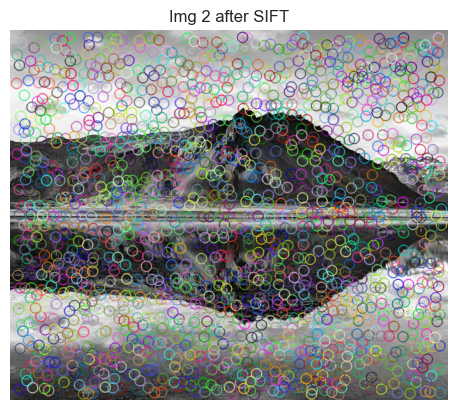

For top_n 100, number of matches: 100 
in RANSAC
Number of inliers: 100
Number of outliers: 0
Average residual for inliers: 1.119392831074369e-12
Average residual for inliers (norm by ransac ts): 3.6742271098485247e-13
Average residual for all the keypoints: 1.119392831074369e-12
Ratio inliers/ top_n keypoints: 1.0


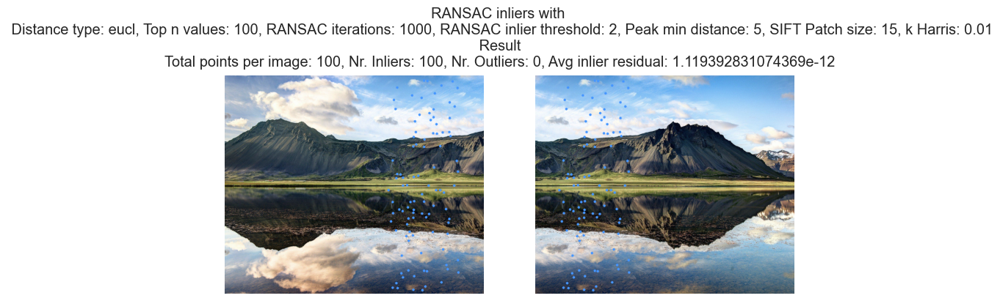

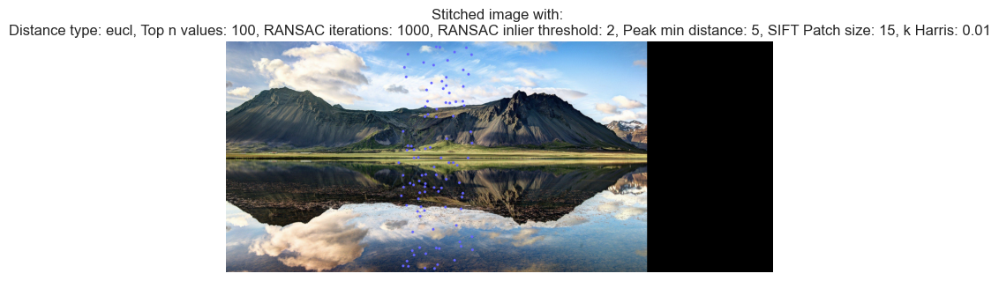

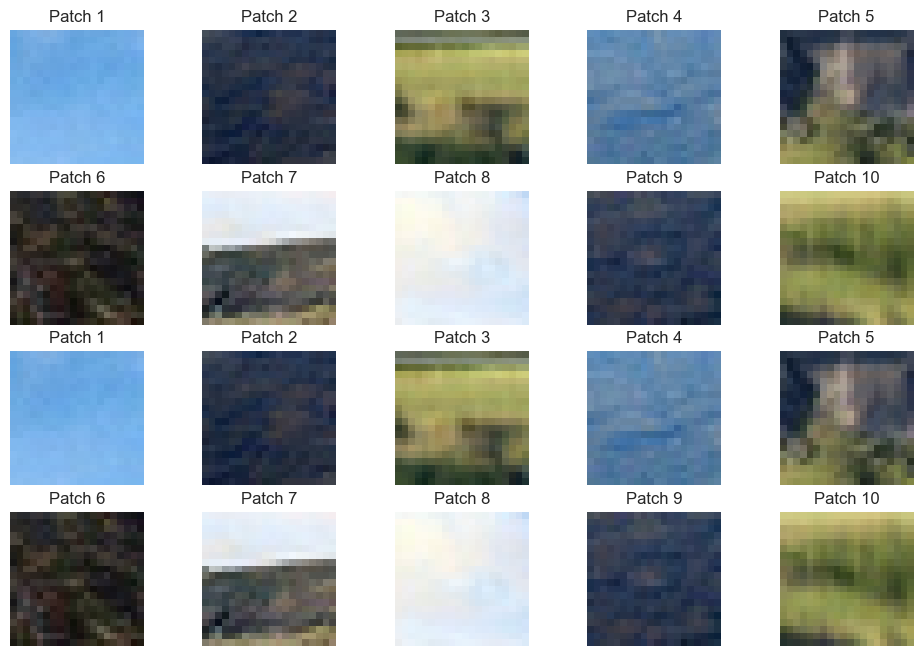

SSIM similarity between inlier patches: 1.0
MSE distance between inlier patches: 0.0
------------------------------------------
save param off off
Higher average SSIM score in inlier patches 1.0  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 1.0


Lower MSE score in inlier patches 0.0  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 1.0


Lower Euclidean residual inliers average (norm) 3.6742271098485247e-13  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 1.0


save off off
{'Distance type': 'eucl', 'Top n values': 100, 'RANSA

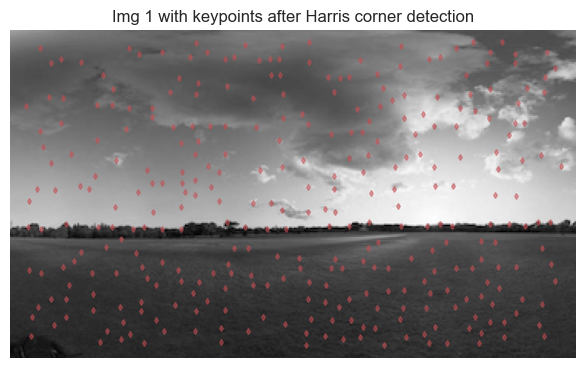

Harris corner detection has found  320 Keypoints in  Img 1  for k= 0.01  min_distance= 5
320


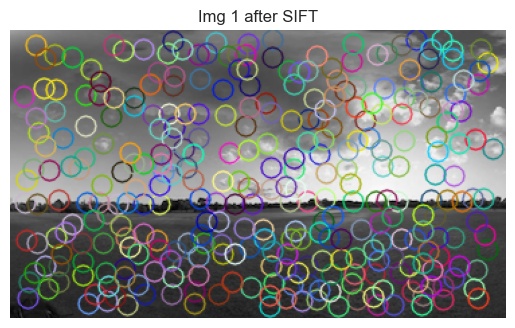

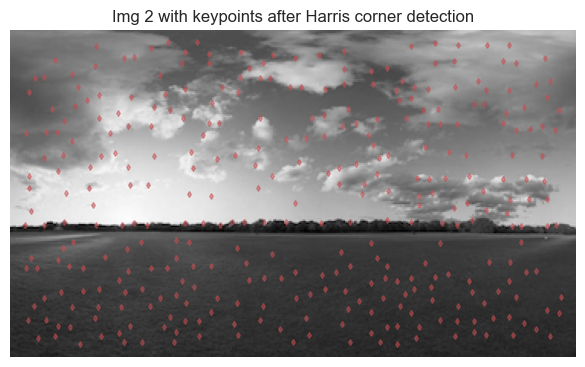

Harris corner detection has found  338 Keypoints in  Img 2  for k= 0.01  min_distance= 5
338


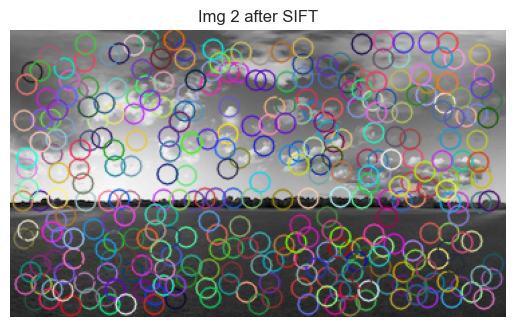

For top_n 100, number of matches: 100 
in RANSAC
Number of inliers: 90
Number of outliers: 10
Average residual for inliers: 2.438660775070205e-12
Average residual for inliers (norm by ransac ts): 9.682161001682804e-13
Average residual for all the keypoints: 0.9730441613155298
Ratio inliers/ top_n keypoints: 0.9


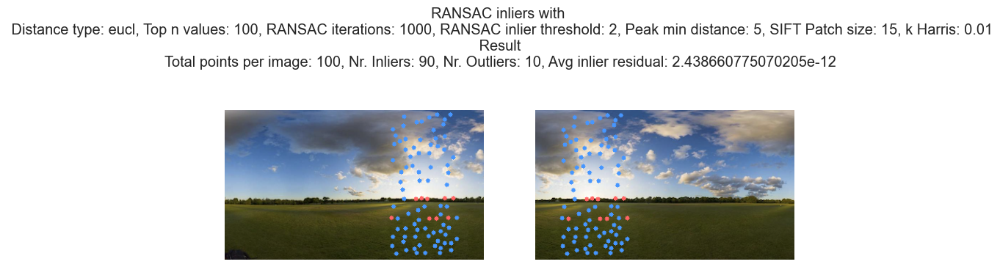

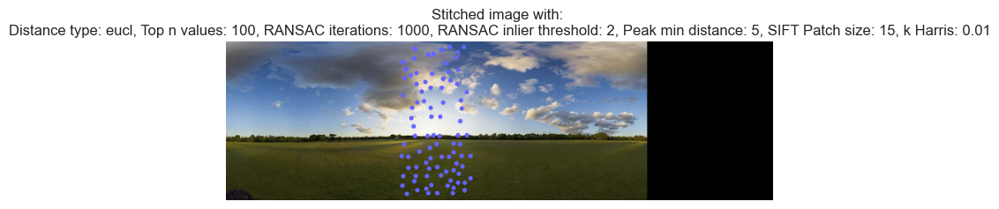

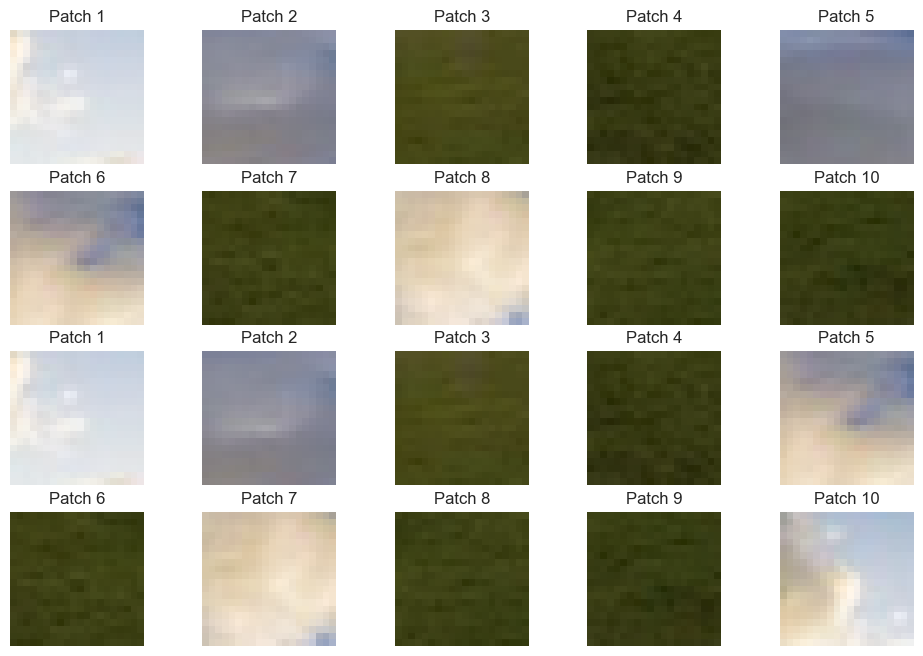

SSIM similarity between inlier patches: 0.3389321027332429
MSE distance between inlier patches: 0.24096754518072291
------------------------------------------
save param off off
Higher average SSIM score in inlier patches 0.3389321027332429  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.9


Lower MSE score in inlier patches 0.24096754518072291  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.9


Lower Euclidean residual inliers average (norm) 9.682161001682804e-13  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.9


save 

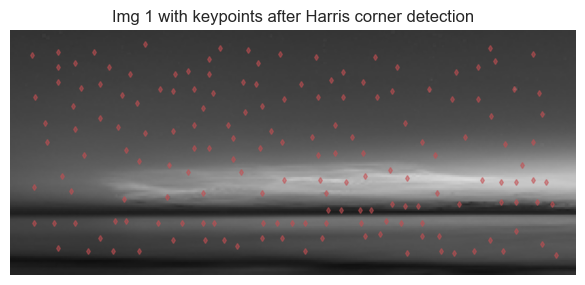

Harris corner detection has found  167 Keypoints in  Img 1  for k= 0.01  min_distance= 5
167


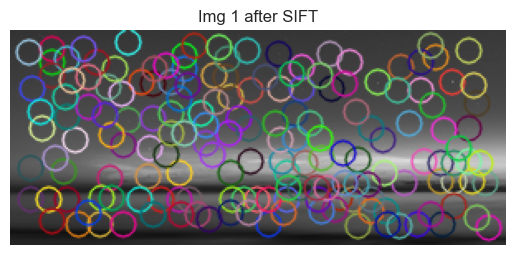

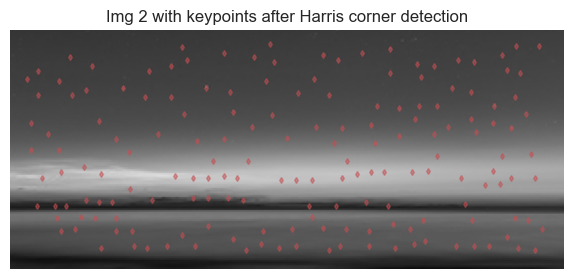

Harris corner detection has found  169 Keypoints in  Img 2  for k= 0.01  min_distance= 5
169


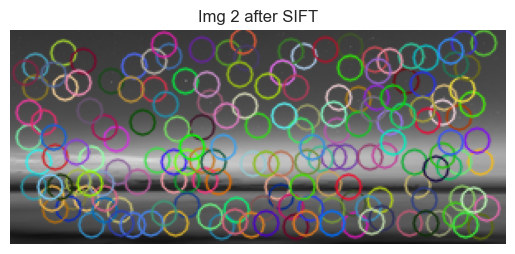

For top_n 100, number of matches: 100 
in RANSAC
Number of inliers: 30
Number of outliers: 70
Average residual for inliers: 1.2810429155724305e-12
Average residual for inliers (norm by ransac ts): 4.0657452020370756e-13
Average residual for all the keypoints: 23.27352415629293
Ratio inliers/ top_n keypoints: 0.3


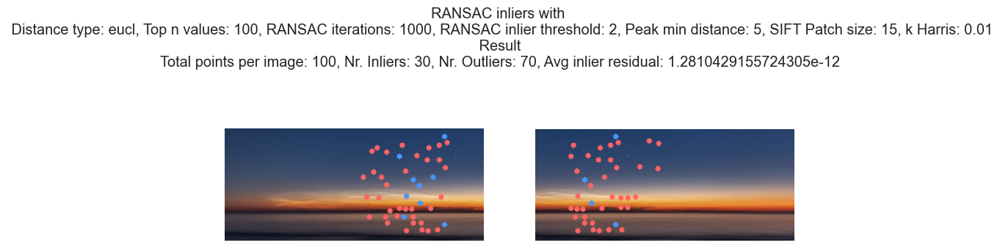

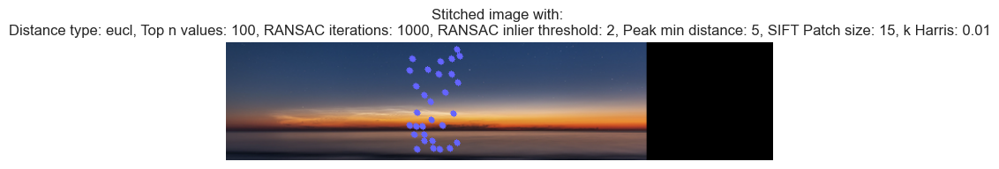

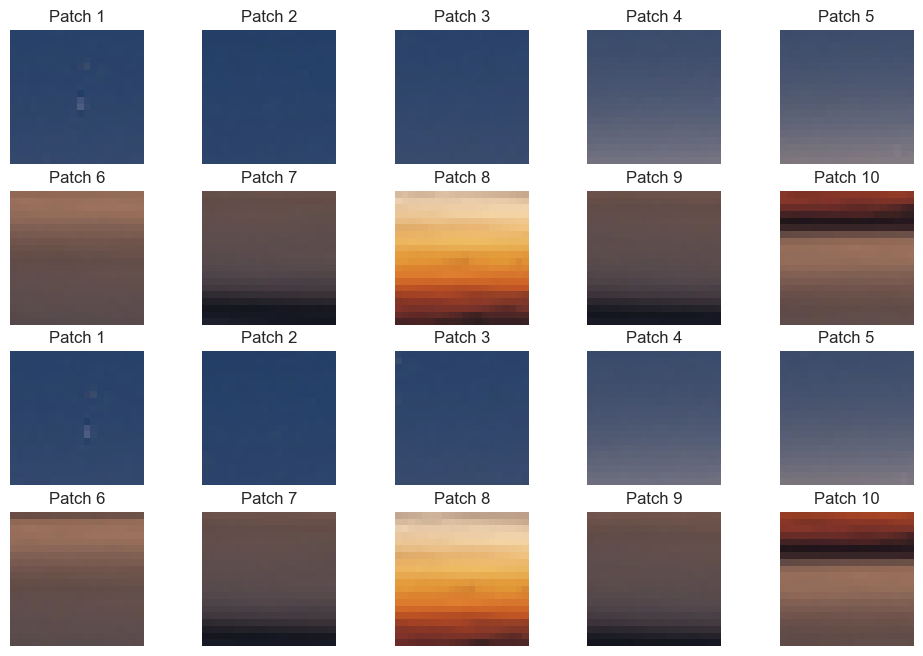

SSIM similarity between inlier patches: 0.9318037945555268
MSE distance between inlier patches: 0.07396099137931035
------------------------------------------
save param off off
Higher average SSIM score in inlier patches 0.9318037945555268  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.3


Lower MSE score in inlier patches 0.07396099137931035  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.3


Lower Euclidean residual inliers average (norm) 4.0657452020370756e-13  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.3


save

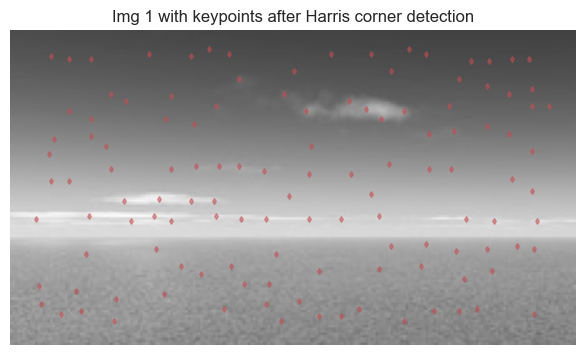

Harris corner detection has found  123 Keypoints in  Img 1  for k= 0.01  min_distance= 5
123


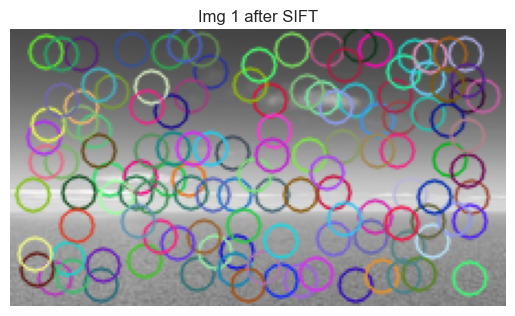

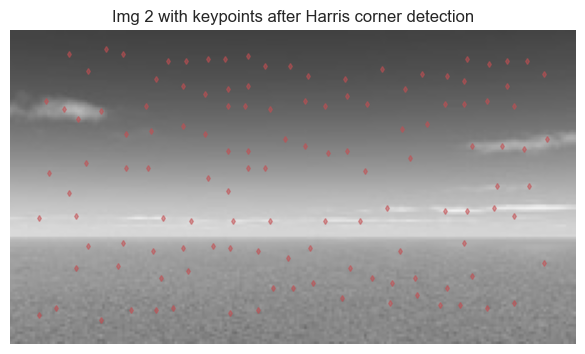

Harris corner detection has found  127 Keypoints in  Img 2  for k= 0.01  min_distance= 5
127


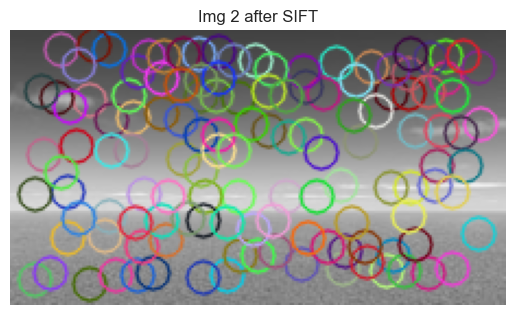

For top_n 100, number of matches: 100 
in RANSAC
Number of inliers: 21
Number of outliers: 79
Average residual for inliers: 4.990716834505465e-15
Average residual for inliers (norm by ransac ts): 2.4953584172527326e-15
Average residual for all the keypoints: 53.05899188062321
Ratio inliers/ top_n keypoints: 0.21


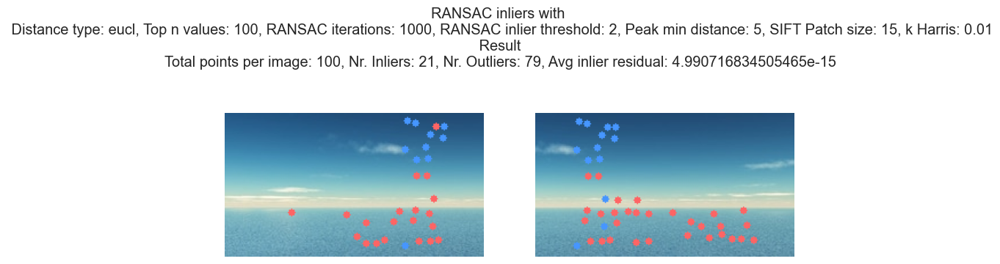

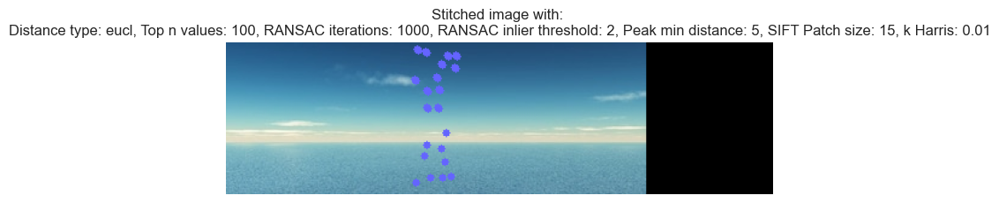

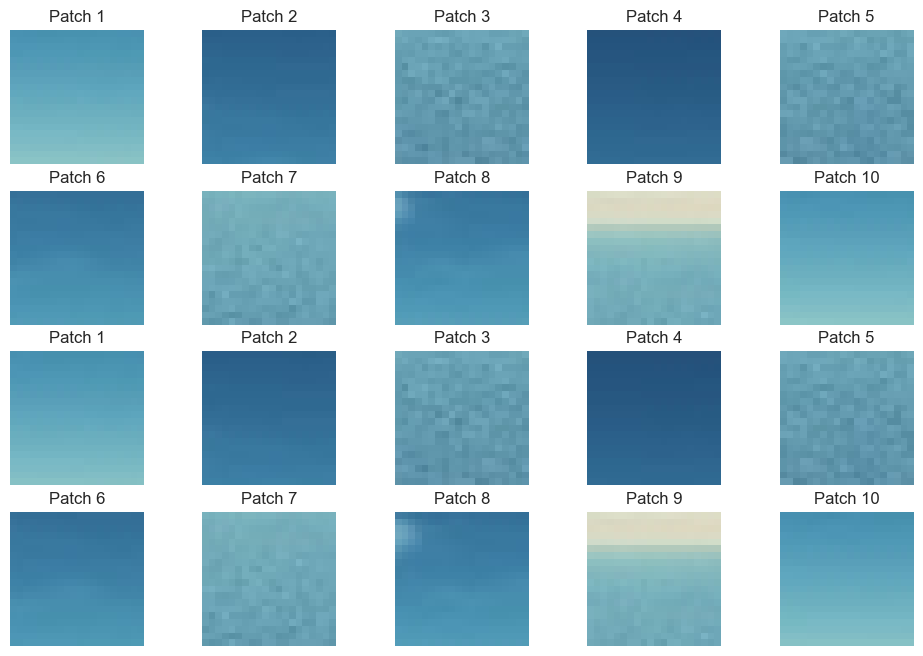

SSIM similarity between inlier patches: 0.9879566030190036
MSE distance between inlier patches: 0.010025347222222224
------------------------------------------
save param off off
Higher average SSIM score in inlier patches 0.9879566030190036  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.21


Lower MSE score in inlier patches 0.010025347222222224  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.21


Lower Euclidean residual inliers average (norm) 2.4953584172527326e-15  obtained with parameters: 

Distance type: eucl
Top n values: 100
RANSAC iterations: 1000
RANSAC inlier threshold: 2
Peak min distance: 5
SIFT Patch size: 15
k Harris: 0.01
with ratio inliers/keypoints: 0.21



In [104]:
img_1 = "images/panorama_1.png"
img_2 = "images/panorama_2.png"
img_3= "images/panorama_3.png"
img_4= "images/panorama_4.png"
img_5= "images/panorama_5.png"

# images are separated from the same image keeping a portion in common between images 



init(json_obj_best, img_1_path=img_1, param_flag='best_ssim', )

init(json_obj_best, img_1_path=img_2,param_flag='best_ssim')
init(json_obj_best,img_1_path=img_3,param_flag='best_ssim' )
init(json_obj_best,img_1_path=img_4, param_flag='best_ssim')
init(json_obj_best, img_1_path=img_5, param_flag='best_ssim')

# Garbage collector 


In [ ]:
gc.collect()

232625